# Exploratory Data Analysis (EDA)
## Satellite Imagery-Based Property Valuation

This notebook covers:
1. **Tabular Data EDA** - Statistical analysis and visualizations
2. **Geospatial Analysis** - Understanding geographic patterns
3. **Image Data EDA** - Visual feature exploration
4. **Multimodal Correlation Analysis** - Linking images to prices

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import os
import glob
from pathlib import Path

# For image processing
import cv2
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

# Geospatial
try:
    import geopandas as gpd
    from shapely.geometry import Point
except:
    print("GeoPandas not available - some geospatial features will be limited")

# Statistical tests
from scipy import stats
from scipy.stats import pearsonr, spearmanr

# Settings
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")
%matplotlib inline

# Display settings
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 100)

# Random seed for reproducibility
np.random.seed(42)

---
## 1. Load Data

Load both tabular data and establish connection to image files.

In [ ]:
# Load tabular data
# Adjust these paths to match your file locations
train_df = pd.read_csv('/content/drive/MyDrive/CDC project/train.csv')
test_df = pd.read_csv('/content/drive/MyDrive/CDC project/test.csv')

# Path to your satellite images
# Adjust this to where you stored the downloaded images
IMAGE_DIR = '/content/drive/MyDrive/CDC project/satellite_images_19 copy'
# TEST_IMAGE_DIR = './satellite_images/test/'

print(f"Training data shape: {train_df.shape}")
print(f"Test data shape: {test_df.shape}")
print(f"\nFirst few rows:")
train_df.head()

Training data shape: (16209, 21)
Test data shape: (5404, 20)

First few rows:


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,9117000170,20150505T000000,268643,4,2.25,1810,9240,2.0,0,0,3,7,1810,0,1961,0,98055,47.4362,-122.187,1660,9240
1,6700390210,20140708T000000,245000,3,2.50,1600,2788,2.0,0,0,4,7,1600,0,1992,0,98031,47.4034,-122.187,1720,3605
2,7212660540,20150115T000000,200000,4,2.50,1720,8638,2.0,0,0,3,8,1720,0,1994,0,98003,47.2704,-122.313,1870,7455
3,8562780200,20150427T000000,352499,2,2.25,1240,705,2.0,0,0,3,7,1150,90,2009,0,98027,47.5321,-122.073,1240,750
4,7760400350,20141205T000000,232000,3,2.00,1280,13356,1.0,0,0,3,7,1280,0,1994,0,98042,47.3715,-122.074,1590,8071


---
## 2. TABULAR DATA EDA

### 2.1 Basic Statistics

In [ ]:
# Data info
print("=" * 60)
print("DATA INFORMATION")
print("=" * 60)
train_df.info()

print("\n" + "=" * 60)
print("MISSING VALUES")
print("=" * 60)
missing = train_df.isnull().sum()
missing_pct = 100 * missing / len(train_df)
missing_table = pd.DataFrame({
    'Missing Count': missing,
    'Percentage': missing_pct
})
print(missing_table[missing_table['Missing Count'] > 0].sort_values('Missing Count', ascending=False))

DATA INFORMATION
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16209 entries, 0 to 16208
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             16209 non-null  int64  
 1   date           16209 non-null  object 
 2   price          16209 non-null  int64  
 3   bedrooms       16209 non-null  int64  
 4   bathrooms      16209 non-null  float64
 5   sqft_living    16209 non-null  int64  
 6   sqft_lot       16209 non-null  int64  
 7   floors         16209 non-null  float64
 8   waterfront     16209 non-null  int64  
 9   view           16209 non-null  int64  
 10  condition      16209 non-null  int64  
 11  grade          16209 non-null  int64  
 12  sqft_above     16209 non-null  int64  
 13  sqft_basement  16209 non-null  int64  
 14  yr_built       16209 non-null  int64  
 15  yr_renovated   16209 non-null  int64  
 16  zipcode        16209 non-null  int64  
 17  lat            16209 non-null  fl

In [ ]:
# Descriptive statistics
print("=" * 60)
print("DESCRIPTIVE STATISTICS")
print("=" * 60)
train_df.describe()

DESCRIPTIVE STATISTICS


,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,1.620900e+04,1.620900e+04,16209.00000,16209.000000,16209.000000,1.620900e+04,16209.000000,16209.000000,16209.000000,16209.000000,16209.000000,16209.000000,16209.000000,16209.000000,16209.000000,16209.000000,16209.000000,16209.000000,16209.000000,16209.000000
mean,4.575771e+09,5.374703e+05,3.36782,2.113054,2073.274601,1.486767e+04,1.498828,0.006971,0.234253,3.407860,7.652971,1784.754396,288.520205,1971.152755,82.738108,98077.974767,47.560707,-122.214003,1983.152261,12735.572707
std,2.874661e+09,3.603036e+05,0.93327,0.765242,907.009491,3.882570e+04,0.543032,0.083206,0.763152,0.651553,1.171050,821.820844,438.598910,29.372698,397.861148,53.355282,0.138340,0.140093,681.905161,26933.162012
min,1.000102e+06,7.500000e+04,0.00000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.159300,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.200000e+05,3.00000,1.500000,1430.000000,5.004000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1200.000000,0.000000,1952.000000,0.000000,98033.000000,47.472500,-122.328000,1480.000000,5098.000000
50%,3.904950e+09,4.500000e+05,3.00000,2.250000,1910.000000,7.599000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.572400,-122.230000,1840.000000,7620.000000
75%,7.304301e+09,6.400000e+05,4.00000,2.500000,2550.000000,1.063100e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2200.000000,560.000000,1997.000000,0.000000,98117.000000,47.678200,-122.125000,2360.000000,10053.000000
max,9.900000e+09,7.700000e+06,33.00000,8.000000,12050.000000,1.164794e+06,3.500000,1.000000,4.000000,5.000000,13.000000,8860.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


### 2.2 Target Variable Analysis (Price)

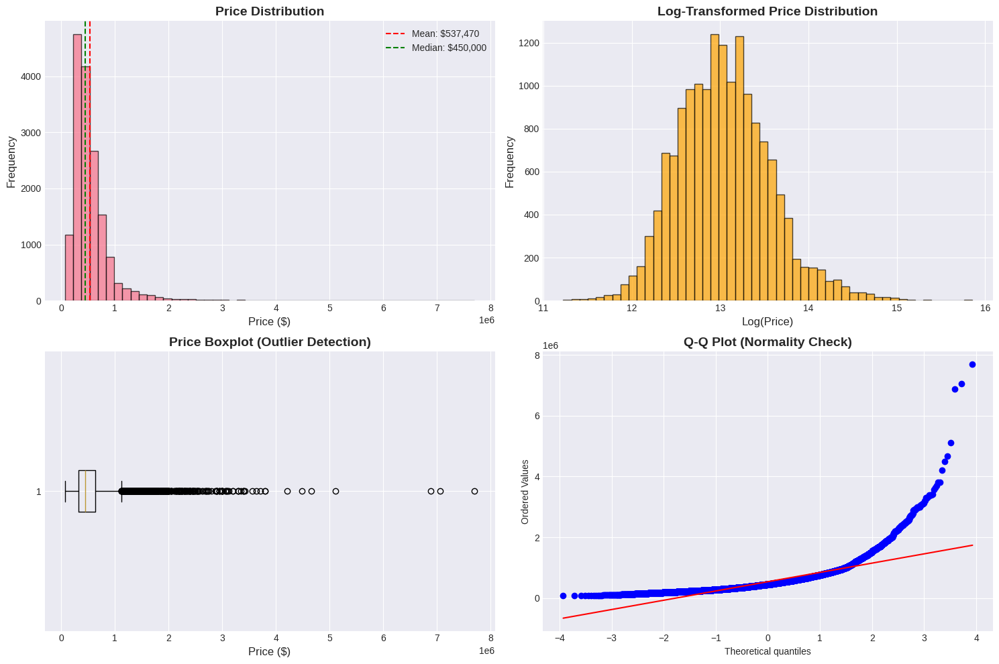


PRICE STATISTICS
Mean Price: $537,470.28
Median Price: $450,000.00
Std Dev: $360,303.58
Min Price: $75,000.00
Max Price: $7,700,000.00
Skewness: 4.03
Kurtosis: 37.11


In [ ]:
# Price distribution analysis
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# Original price distribution
axes[0, 0].hist(train_df['price'], bins=50, edgecolor='black', alpha=0.7)
axes[0, 0].set_xlabel('Price ($)', fontsize=12)
axes[0, 0].set_ylabel('Frequency', fontsize=12)
axes[0, 0].set_title('Price Distribution', fontsize=14, fontweight='bold')
axes[0, 0].axvline(train_df['price'].mean(), color='red', linestyle='--', label=f'Mean: ${train_df["price"].mean():,.0f}')
axes[0, 0].axvline(train_df['price'].median(), color='green', linestyle='--', label=f'Median: ${train_df["price"].median():,.0f}')
axes[0, 0].legend()

# Log-transformed price
axes[0, 1].hist(np.log1p(train_df['price']), bins=50, edgecolor='black', alpha=0.7, color='orange')
axes[0, 1].set_xlabel('Log(Price)', fontsize=12)
axes[0, 1].set_ylabel('Frequency', fontsize=12)
axes[0, 1].set_title('Log-Transformed Price Distribution', fontsize=14, fontweight='bold')

# Box plot
axes[1, 0].boxplot(train_df['price'], vert=False)
axes[1, 0].set_xlabel('Price ($)', fontsize=12)
axes[1, 0].set_title('Price Boxplot (Outlier Detection)', fontsize=14, fontweight='bold')

# Q-Q plot for normality
stats.probplot(train_df['price'], dist="norm", plot=axes[1, 1])
axes[1, 1].set_title('Q-Q Plot (Normality Check)', fontsize=14, fontweight='bold')

plt.tight_layout()
plt.show()

# Price statistics
print("\n" + "=" * 60)
print("PRICE STATISTICS")
print("=" * 60)
print(f"Mean Price: ${train_df['price'].mean():,.2f}")
print(f"Median Price: ${train_df['price'].median():,.2f}")
print(f"Std Dev: ${train_df['price'].std():,.2f}")
print(f"Min Price: ${train_df['price'].min():,.2f}")
print(f"Max Price: ${train_df['price'].max():,.2f}")
print(f"Skewness: {train_df['price'].skew():.2f}")
print(f"Kurtosis: {train_df['price'].kurtosis():.2f}")

### 2.3 Feature Distributions

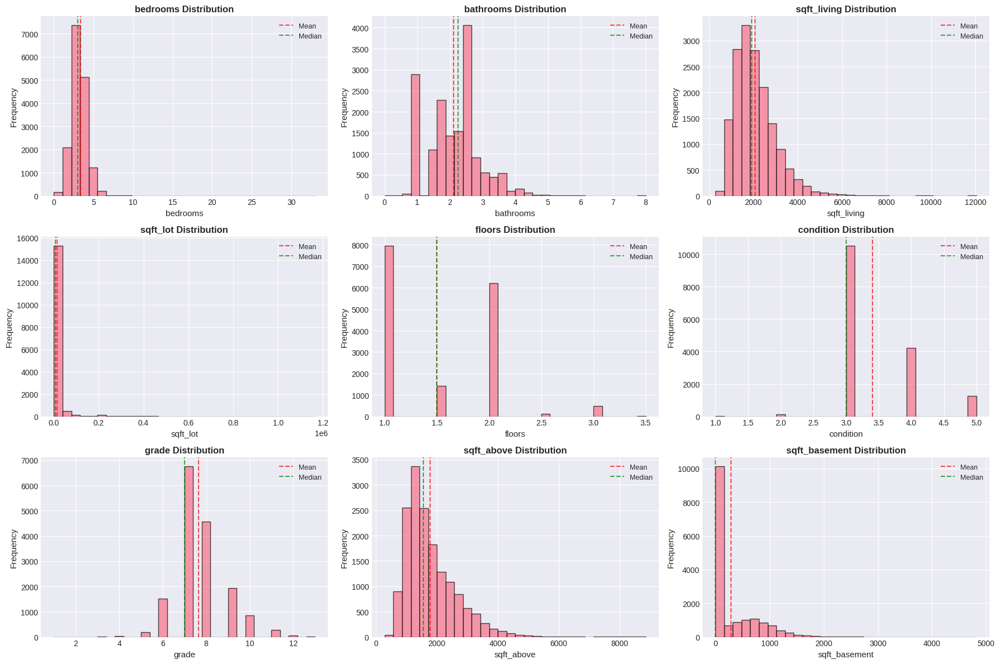

In [ ]:
# Identify numerical and categorical columns
numerical_cols = train_df.select_dtypes(include=[np.number]).columns.tolist()
# Remove id and target if present
numerical_cols = [col for col in numerical_cols if col not in ['id', 'price']]

# Plot distributions for key numerical features
key_features = ['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot',
                'floors', 'condition', 'grade', 'sqft_above', 'sqft_basement']
key_features = [f for f in key_features if f in train_df.columns]

n_cols = 3
n_rows = (len(key_features) + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, n_rows * 4))
axes = axes.flatten()

for idx, col in enumerate(key_features):
    axes[idx].hist(train_df[col].dropna(), bins=30, edgecolor='black', alpha=0.7)
    axes[idx].set_xlabel(col, fontsize=11)
    axes[idx].set_ylabel('Frequency', fontsize=11)
    axes[idx].set_title(f'{col} Distribution', fontsize=12, fontweight='bold')
    axes[idx].axvline(train_df[col].mean(), color='red', linestyle='--', alpha=0.7, label='Mean')
    axes[idx].axvline(train_df[col].median(), color='green', linestyle='--', alpha=0.7, label='Median')
    axes[idx].legend(fontsize=9)

# Hide unused subplots
for idx in range(len(key_features), len(axes)):
    axes[idx].axis('off')

plt.tight_layout()
plt.show()

### 2.4 Categorical Features Analysis

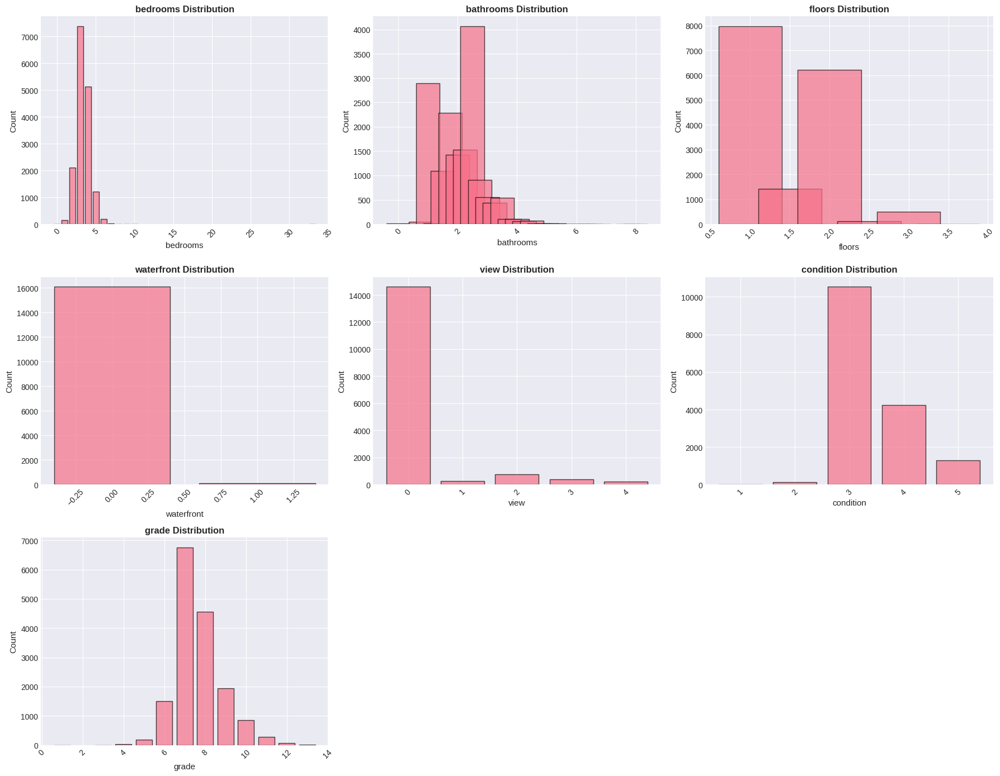

In [ ]:
# Analyze categorical/ordinal features
categorical_features = ['bedrooms', 'bathrooms', 'floors', 'waterfront',
                        'view', 'condition', 'grade']
categorical_features = [f for f in categorical_features if f in train_df.columns]

fig, axes = plt.subplots(3, 3, figsize=(18, 14))
axes = axes.flatten()

for idx, col in enumerate(categorical_features):
    value_counts = train_df[col].value_counts().sort_index()
    axes[idx].bar(value_counts.index, value_counts.values, edgecolor='black', alpha=0.7)
    axes[idx].set_xlabel(col, fontsize=11)
    axes[idx].set_ylabel('Count', fontsize=11)
    axes[idx].set_title(f'{col} Distribution', fontsize=12, fontweight='bold')
    axes[idx].tick_params(axis='x', rotation=45)

# Hide unused subplots
for idx in range(len(categorical_features), len(axes)):
    axes[idx].axis('off')

plt.tight_layout()
plt.show()

### 2.5 Correlation Analysis

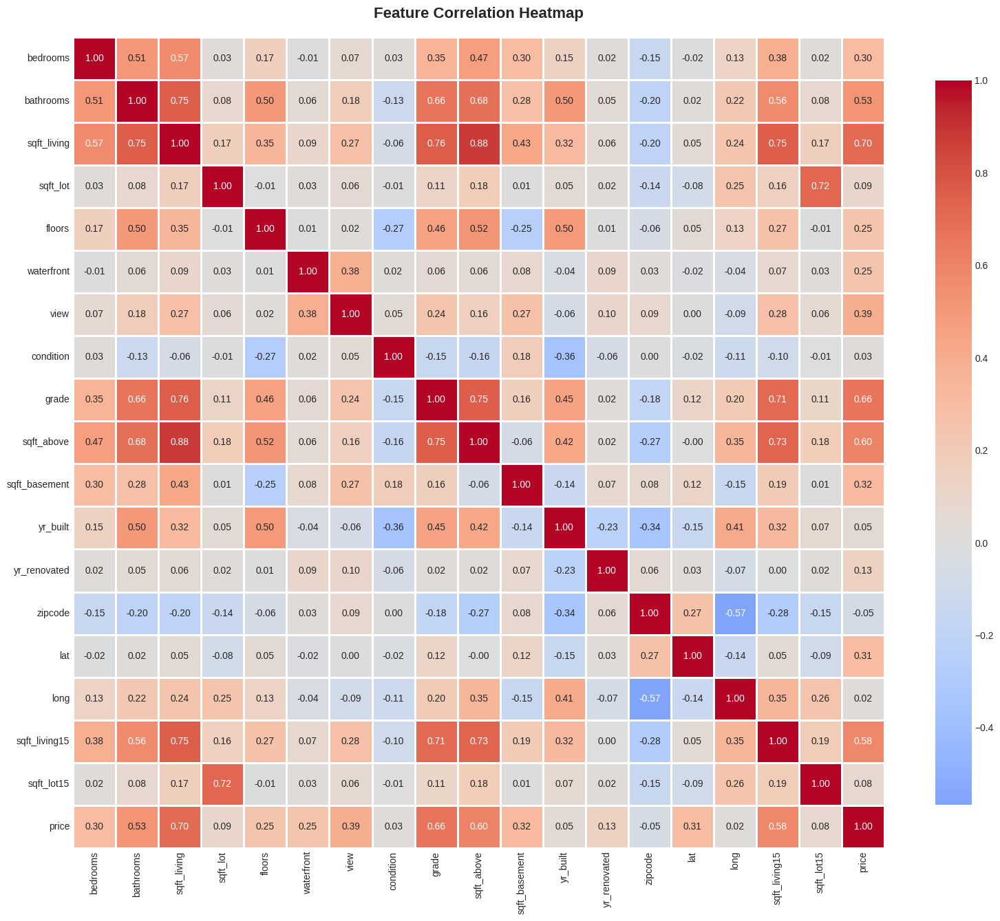


CORRELATION WITH PRICE
price            1.000000
sqft_living      0.700933
grade            0.664266
sqft_above       0.602648
sqft_living15    0.581781
bathrooms        0.525487
view             0.390534
sqft_basement    0.320301
lat              0.310008
bedrooms         0.304454
floors           0.251428
waterfront       0.245221
yr_renovated     0.133075
sqft_lot         0.088526
sqft_lot15       0.076060
yr_built         0.048307
condition        0.031333
long             0.024279
zipcode         -0.054517
Name: price, dtype: float64


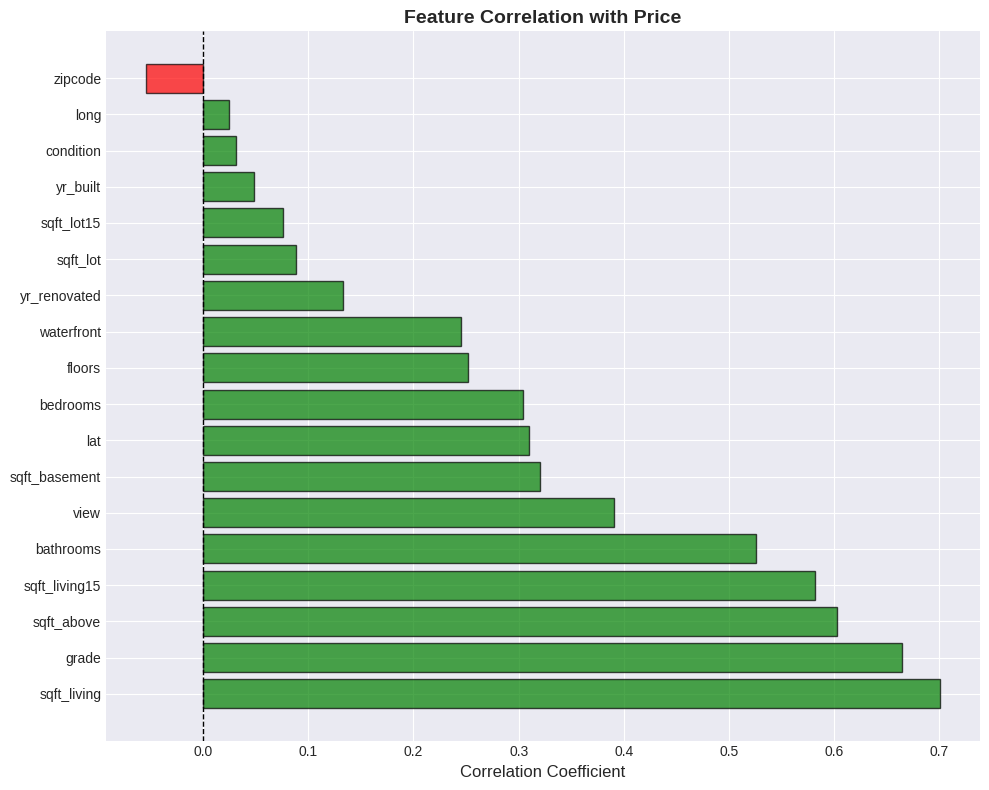

In [ ]:
# Correlation matrix
numerical_for_corr = [col for col in numerical_cols if col in train_df.columns] + ['price']
correlation_matrix = train_df[numerical_for_corr].corr()

# Full correlation heatmap
plt.figure(figsize=(16, 14))
sns.heatmap(correlation_matrix, annot=True, fmt='.2f', cmap='coolwarm',
            center=0, square=True, linewidths=1, cbar_kws={"shrink": 0.8})
plt.title('Feature Correlation Heatmap', fontsize=16, fontweight='bold', pad=20)
plt.tight_layout()
plt.show()

# Correlation with price (sorted)
price_corr = correlation_matrix['price'].sort_values(ascending=False)
print("\n" + "=" * 60)
print("CORRELATION WITH PRICE")
print("=" * 60)
print(price_corr)

# Visualize correlations with price
plt.figure(figsize=(10, 8))
price_corr_plot = price_corr.drop('price')  # Remove self-correlation
colors = ['green' if x > 0 else 'red' for x in price_corr_plot.values]
plt.barh(range(len(price_corr_plot)), price_corr_plot.values, color=colors, alpha=0.7, edgecolor='black')
plt.yticks(range(len(price_corr_plot)), price_corr_plot.index)
plt.xlabel('Correlation Coefficient', fontsize=12)
plt.title('Feature Correlation with Price', fontsize=14, fontweight='bold')
plt.axvline(x=0, color='black', linestyle='--', linewidth=1)
plt.tight_layout()
plt.show()

### 2.6 Feature Relationships with Price

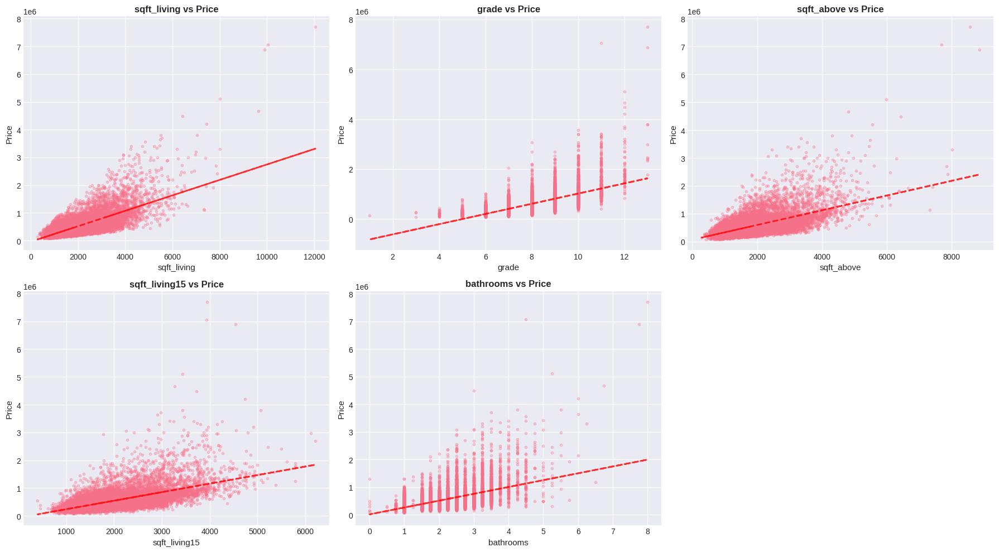

In [ ]:
# Scatter plots: Key features vs Price
important_features = ['sqft_living', 'grade', 'sqft_above', 'sqft_living15', 'bathrooms']
important_features = [f for f in important_features if f in train_df.columns]

fig, axes = plt.subplots(2, 3, figsize=(18, 10))
axes = axes.flatten()

for idx, feature in enumerate(important_features):
    axes[idx].scatter(train_df[feature], train_df['price'], alpha=0.3, s=10)
    axes[idx].set_xlabel(feature, fontsize=11)
    axes[idx].set_ylabel('Price', fontsize=11)
    axes[idx].set_title(f'{feature} vs Price', fontsize=12, fontweight='bold')

    # Add regression line
    z = np.polyfit(train_df[feature].dropna(), train_df.loc[train_df[feature].notna(), 'price'], 1)
    p = np.poly1d(z)
    axes[idx].plot(train_df[feature], p(train_df[feature]), "r--", alpha=0.8, linewidth=2)

# Hide unused subplot
for idx in range(len(important_features), len(axes)):
    axes[idx].axis('off')

plt.tight_layout()
plt.show()

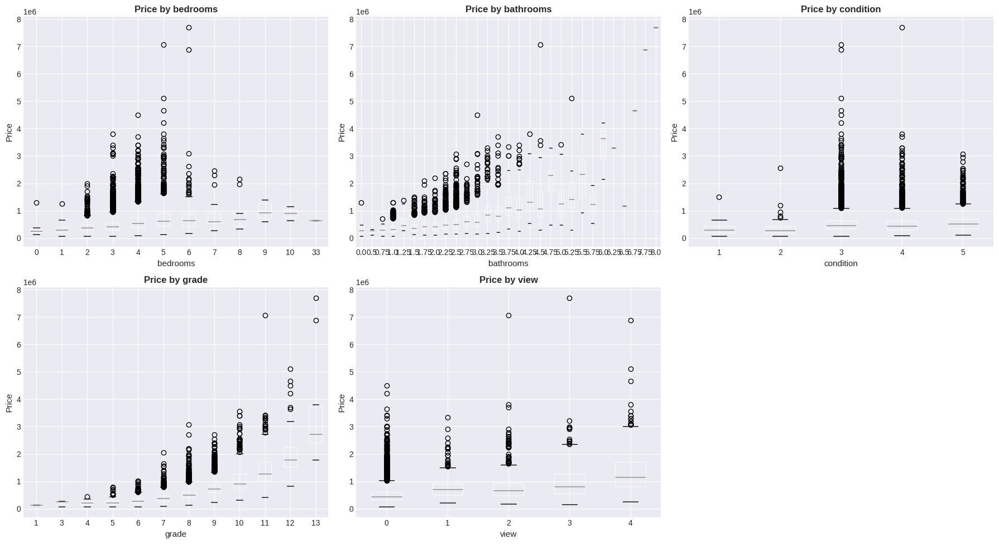

In [ ]:
# Box plots: Categorical features vs Price
categorical_vs_price = ['bedrooms', 'bathrooms', 'condition', 'grade', 'view']
categorical_vs_price = [f for f in categorical_vs_price if f in train_df.columns]

fig, axes = plt.subplots(2, 3, figsize=(18, 10))
axes = axes.flatten()

for idx, feature in enumerate(categorical_vs_price):
    train_df.boxplot(column='price', by=feature, ax=axes[idx])
    axes[idx].set_xlabel(feature, fontsize=11)
    axes[idx].set_ylabel('Price', fontsize=11)
    axes[idx].set_title(f'Price by {feature}', fontsize=12, fontweight='bold')
    axes[idx].get_figure().suptitle('')  # Remove default title

# Hide unused subplot
for idx in range(len(categorical_vs_price), len(axes)):
    axes[idx].axis('off')

plt.tight_layout()
plt.show()

---
## 3. GEOSPATIAL ANALYSIS

### 3.1 Geographic Distribution

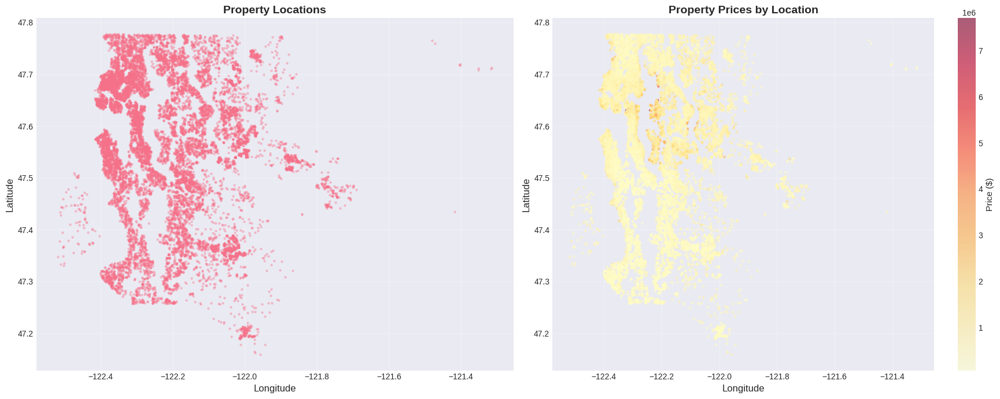

In [ ]:
# Geographic scatter plot
fig, axes = plt.subplots(1, 2, figsize=(18, 7))

# Simple location plot
axes[0].scatter(train_df['long'], train_df['lat'], alpha=0.3, s=5)
axes[0].set_xlabel('Longitude', fontsize=12)
axes[0].set_ylabel('Latitude', fontsize=12)
axes[0].set_title('Property Locations', fontsize=14, fontweight='bold')
axes[0].grid(True, alpha=0.3)

# Price heatmap on geography
scatter = axes[1].scatter(train_df['long'], train_df['lat'],
                         c=train_df['price'], cmap='YlOrRd',
                         alpha=0.6, s=10, edgecolors='none')
axes[1].set_xlabel('Longitude', fontsize=12)
axes[1].set_ylabel('Latitude', fontsize=12)
axes[1].set_title('Property Prices by Location', fontsize=14, fontweight='bold')
axes[1].grid(True, alpha=0.3)
cbar = plt.colorbar(scatter, ax=axes[1])
cbar.set_label('Price ($)', fontsize=11)

plt.tight_layout()
plt.show()

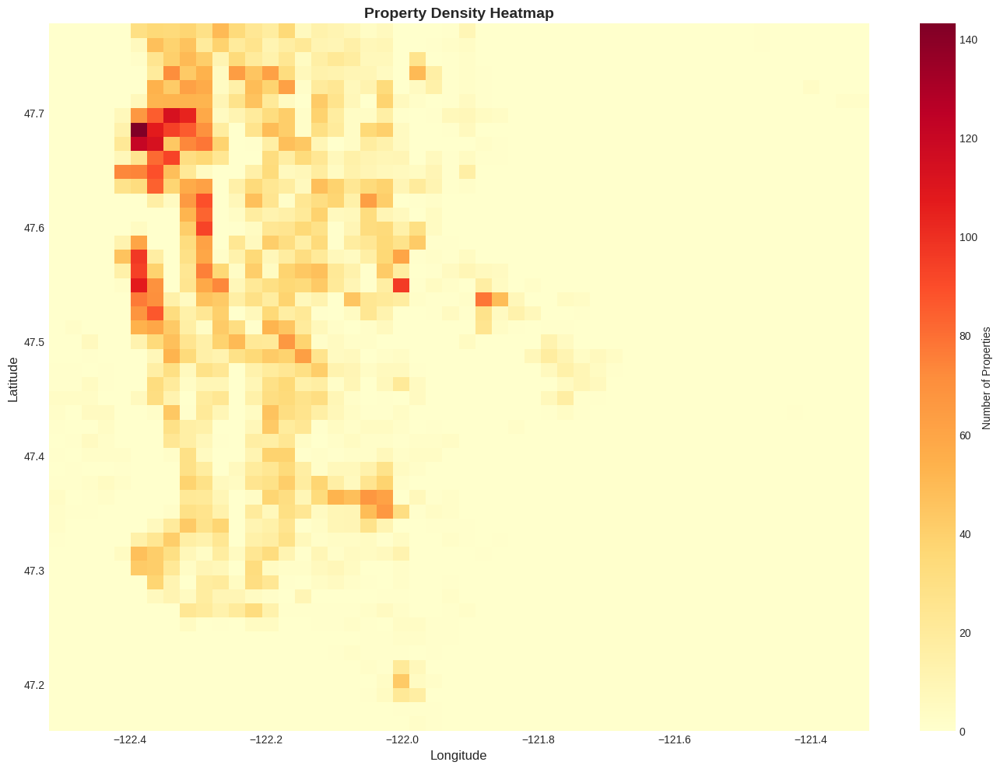

In [ ]:
# 2D Histogram / Heatmap of property density
plt.figure(figsize=(14, 10))
plt.hist2d(train_df['long'], train_df['lat'], bins=50, cmap='YlOrRd')
plt.colorbar(label='Number of Properties')
plt.xlabel('Longitude', fontsize=12)
plt.ylabel('Latitude', fontsize=12)
plt.title('Property Density Heatmap', fontsize=14, fontweight='bold')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

### 3.2 Spatial Price Patterns

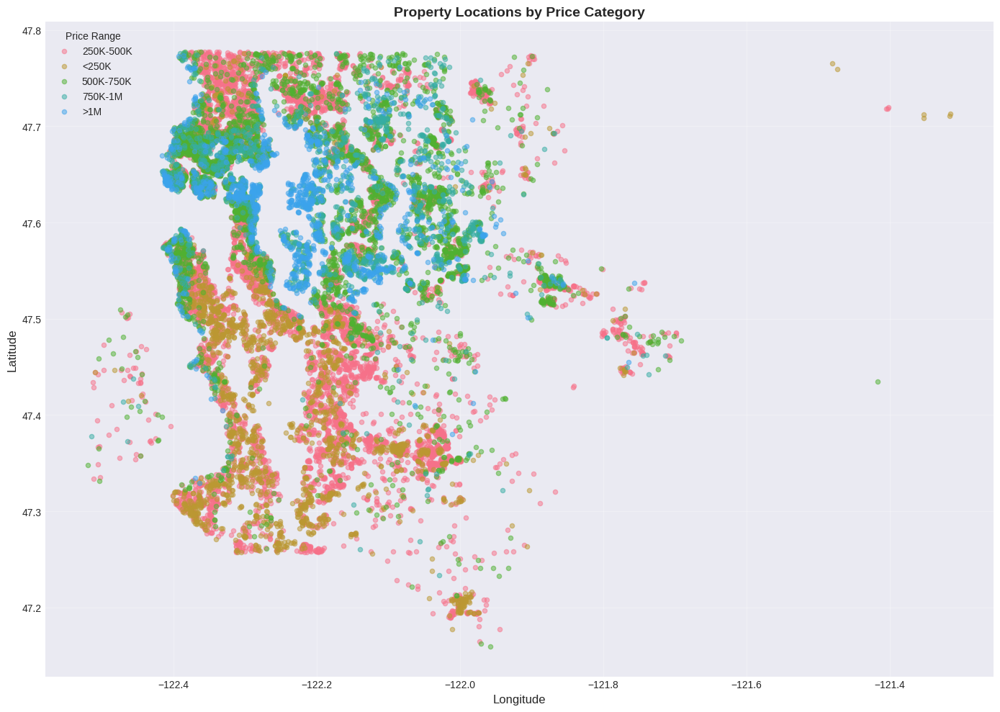

In [ ]:
# Create price bins for analysis
train_df['price_category'] = pd.cut(train_df['price'],
                                     bins=[0, 250000, 500000, 750000, 1000000, float('inf')],
                                     labels=['<250K', '250K-500K', '500K-750K', '750K-1M', '>1M'])

# Plot different price categories
plt.figure(figsize=(14, 10))
for category in train_df['price_category'].unique():
    subset = train_df[train_df['price_category'] == category]
    plt.scatter(subset['long'], subset['lat'], label=category, alpha=0.5, s=20)

plt.xlabel('Longitude', fontsize=12)
plt.ylabel('Latitude', fontsize=12)
plt.title('Property Locations by Price Category', fontsize=14, fontweight='bold')
plt.legend(title='Price Range', fontsize=10)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

---
## 4. IMAGE DATA EDA

### 4.1 Sample Images Visualization

Found 16209 images


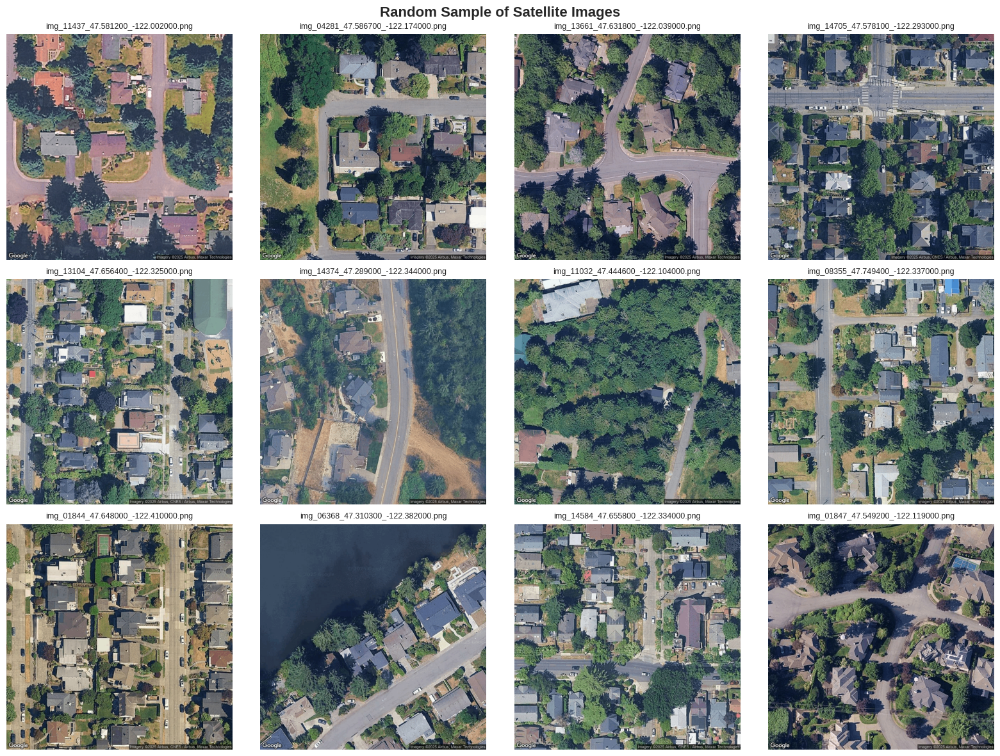

In [ ]:
# Function to load and display sample images
def load_sample_images(image_dir, n_samples=12, pattern='*.png'):
    """
    Load sample images from directory

    Args:
        image_dir: Directory containing images
        n_samples: Number of samples to display
        pattern: File pattern (*.png, *.jpg, etc.)
    """
    image_files = glob.glob(os.path.join(image_dir, pattern))

    if len(image_files) == 0:
        # Try alternative patterns
        for ext in ['*.jpg', '*.jpeg', '*.png']:
            image_files = glob.glob(os.path.join(image_dir, ext))
            if len(image_files) > 0:
                break

    if len(image_files) == 0:
        print(f"No images found in {image_dir}")
        return None

    print(f"Found {len(image_files)} images")
    sample_files = np.random.choice(image_files, min(n_samples, len(image_files)), replace=False)

    return sample_files

# Display random sample images
sample_image_files = load_sample_images(IMAGE_DIR, n_samples=12)

if sample_image_files is not None:
    fig, axes = plt.subplots(3, 4, figsize=(16, 12))
    axes = axes.flatten()

    for idx, img_path in enumerate(sample_image_files):
        img = Image.open(img_path)
        axes[idx].imshow(img)
        axes[idx].axis('off')

        # Extract property ID from filename if possible
        filename = os.path.basename(img_path)
        axes[idx].set_title(f'{filename}', fontsize=9)

    plt.suptitle('Random Sample of Satellite Images', fontsize=16, fontweight='bold')
    plt.tight_layout()
    plt.show()
else:
    print("Please update IMAGE_DIR path to point to your satellite images folder")

### 4.2 Images by Price Range

This helps us understand visual differences between cheap and expensive properties.

In [ ]:
train_df["image_name"] = train_df.apply(
    lambda row: f"img_{row.name:05d}_{row.lat:.6f}_{row.long:.6f}.png",
    axis=1
)

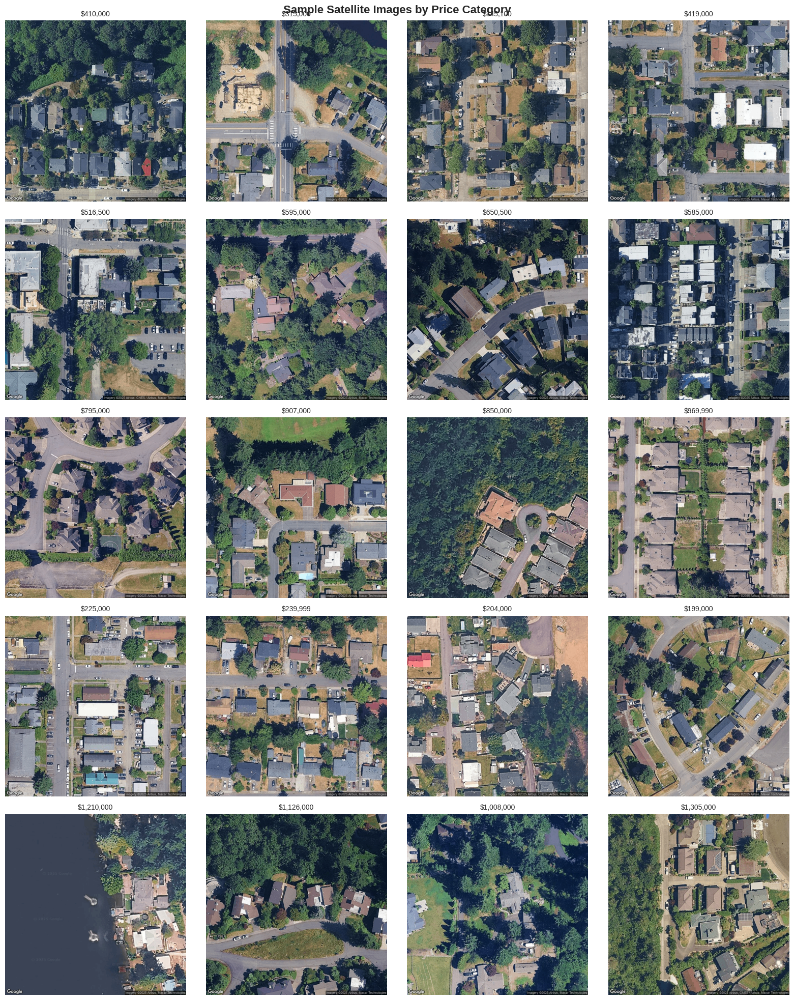

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image


def display_images_by_price(df, image_dir, n_per_category=4):
    """
    Display sample satellite images grouped by price category.

    Assumes:
    - df contains columns: 'price' and 'image_name'
    - image_name contains the exact filename present in image_dir
    """

    # ----------------------------------
    # 1️⃣ CREATE PRICE CATEGORIES
    # ----------------------------------
    if "price_category" not in df.columns:
        df = df.copy()
        df["price_category"] = pd.cut(
            df["price"],
            bins=[0, 250_000, 500_000, 750_000, 1_000_000, float("inf")],
            labels=["<250K", "250K-500K", "500K-750K", "750K-1M", ">1M"]
        )

    categories = (
        df["price_category"]
        .dropna()
        .unique()
        .tolist()
    )

    categories = sorted(categories)

    # ----------------------------------
    # 2️⃣ CREATE PLOT GRID
    # ----------------------------------
    fig, axes = plt.subplots(
        nrows=len(categories),
        ncols=n_per_category,
        figsize=(4 * n_per_category, 4 * len(categories))
    )

    if len(categories) == 1:
        axes = axes.reshape(1, -1)

    # ----------------------------------
    # 3️⃣ LOOP OVER CATEGORIES
    # ----------------------------------
    for cat_idx, category in enumerate(categories):

        cat_df = df[df["price_category"] == category]

        sample_df = cat_df.sample(
            min(n_per_category, len(cat_df)),
            random_state=42
        )

        for img_idx, (_, row) in enumerate(sample_df.iterrows()):
            ax = axes[cat_idx, img_idx]

            img_path = os.path.join(image_dir, row["image_name"])

            if os.path.exists(img_path):
                img = Image.open(img_path).convert("RGB")
                ax.imshow(img)
                ax.set_title(f"${row['price']:,.0f}", fontsize=10)
            else:
                ax.text(
                    0.5, 0.5,
                    "Image\nNot Found",
                    ha="center",
                    va="center",
                    fontsize=10
                )

            ax.axis("off")

        # Category label on the left
        axes[cat_idx, 0].set_ylabel(
            f"{category}",
            fontsize=12,
            fontweight="bold",
            rotation=0,
            labelpad=50
        )

    # ----------------------------------
    # 4️⃣ FINAL FORMATTING
    # ----------------------------------
    plt.suptitle(
        "Sample Satellite Images by Price Category",
        fontsize=16,
        fontweight="bold"
    )

    plt.tight_layout()
    plt.show()

display_images_by_price(train_df, IMAGE_DIR, n_per_category=4)


### 4.3 Image Properties Analysis

IMAGE PROPERTIES ANALYSIS
Total images analyzed: 100

Unique dimensions: 1
Dimensions found: {(640, 640)}

File size statistics (KB):
  Mean: 305.76
  Median: 307.14
  Min: 268.66
  Max: 335.91


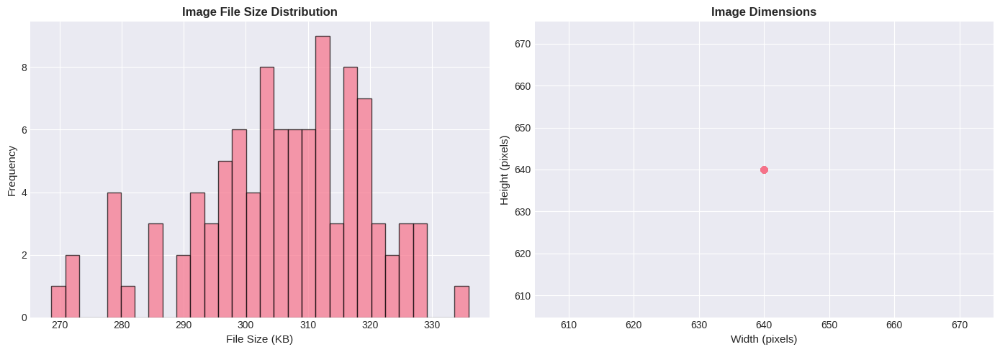

In [ ]:
# Analyze basic image properties
def analyze_image_properties(image_dir, sample_size=100):
    """
    Analyze dimensions, file sizes, and basic statistics of images
    """
    image_files = glob.glob(os.path.join(image_dir, '*.*'))
    image_files = [f for f in image_files if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    if len(image_files) == 0:
        print("No images found")
        return

    sample_files = np.random.choice(image_files, min(sample_size, len(image_files)), replace=False)

    dimensions = []
    file_sizes = []

    for img_path in sample_files:
        try:
            img = Image.open(img_path)
            dimensions.append(img.size)  # (width, height)
            file_sizes.append(os.path.getsize(img_path) / 1024)  # KB
        except:
            continue

    # Analysis
    print("="*60)
    print("IMAGE PROPERTIES ANALYSIS")
    print("="*60)
    print(f"Total images analyzed: {len(dimensions)}")
    print(f"\nUnique dimensions: {len(set(dimensions))}")

    if len(set(dimensions)) <= 5:
        print(f"Dimensions found: {set(dimensions)}")

    print(f"\nFile size statistics (KB):")
    print(f"  Mean: {np.mean(file_sizes):.2f}")
    print(f"  Median: {np.median(file_sizes):.2f}")
    print(f"  Min: {np.min(file_sizes):.2f}")
    print(f"  Max: {np.max(file_sizes):.2f}")

    # Visualize
    fig, axes = plt.subplots(1, 2, figsize=(14, 5))

    # File size distribution
    axes[0].hist(file_sizes, bins=30, edgecolor='black', alpha=0.7)
    axes[0].set_xlabel('File Size (KB)', fontsize=11)
    axes[0].set_ylabel('Frequency', fontsize=11)
    axes[0].set_title('Image File Size Distribution', fontsize=12, fontweight='bold')

    # Dimension scatter
    widths = [d[0] for d in dimensions]
    heights = [d[1] for d in dimensions]
    axes[1].scatter(widths, heights, alpha=0.5)
    axes[1].set_xlabel('Width (pixels)', fontsize=11)
    axes[1].set_ylabel('Height (pixels)', fontsize=11)
    axes[1].set_title('Image Dimensions', fontsize=12, fontweight='bold')

    plt.tight_layout()
    plt.show()

analyze_image_properties(IMAGE_DIR, sample_size=100)

### 4.4 Color Analysis

Analyze color distributions to understand environmental features (green = vegetation, blue = water, gray = urban)

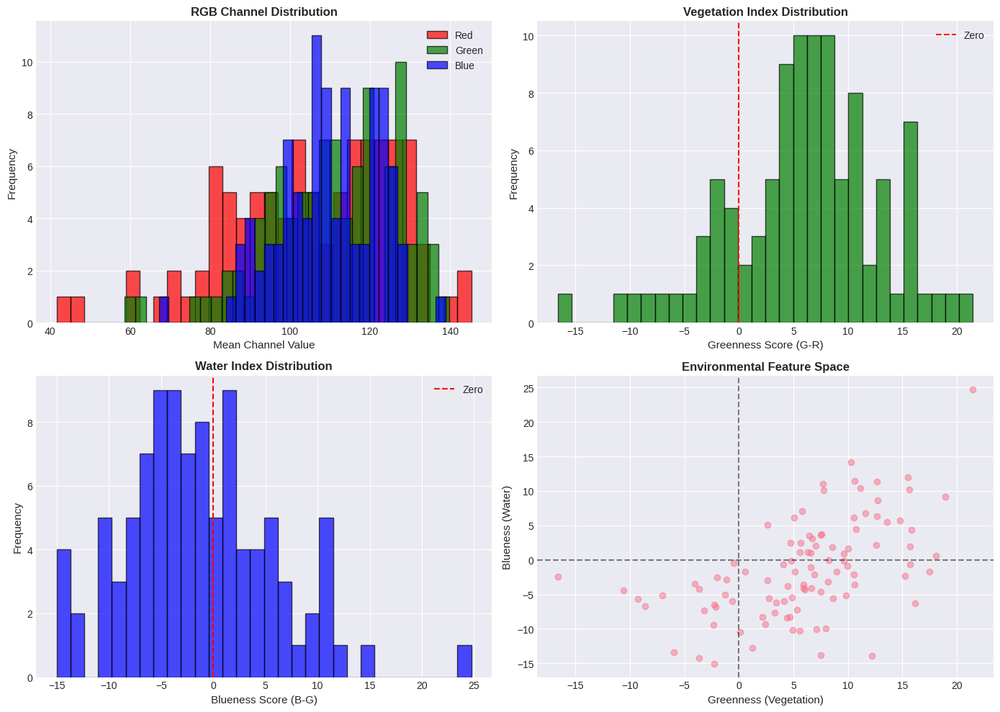


COLOR ANALYSIS SUMMARY
Mean Greenness Score: 6.00
Mean Blueness Score: -1.30

Interpretation:
  - Positive greenness → More vegetation
  - Positive blueness → More water features
  - Negative scores → More urban/developed


In [ ]:
def analyze_image_colors(image_dir, n_samples=50):
    """
    Analyze color distributions in satellite images
    Green = vegetation, Blue = water, Gray/Brown = urban
    """
    image_files = glob.glob(os.path.join(image_dir, '*.*'))
    image_files = [f for f in image_files if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    if len(image_files) == 0:
        print("No images found")
        return

    sample_files = np.random.choice(image_files, min(n_samples, len(image_files)), replace=False)

    all_colors = {'R': [], 'G': [], 'B': []}
    greenness_scores = []
    blueness_scores = []

    for img_path in sample_files:
        try:
            img = cv2.imread(img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

            # Get mean colors
            mean_colors = img.mean(axis=(0, 1))
            all_colors['R'].append(mean_colors[0])
            all_colors['G'].append(mean_colors[1])
            all_colors['B'].append(mean_colors[2])

            # Calculate greenness (G - R, higher = more vegetation)
            greenness = mean_colors[1] - mean_colors[0]
            greenness_scores.append(greenness)

            # Calculate blueness (B - G, higher = more water)
            blueness = mean_colors[2] - mean_colors[1]
            blueness_scores.append(blueness)

        except:
            continue

    # Visualization
    fig, axes = plt.subplots(2, 2, figsize=(14, 10))

    # RGB Distribution
    axes[0, 0].hist(all_colors['R'], bins=30, alpha=0.7, color='red', label='Red', edgecolor='black')
    axes[0, 0].hist(all_colors['G'], bins=30, alpha=0.7, color='green', label='Green', edgecolor='black')
    axes[0, 0].hist(all_colors['B'], bins=30, alpha=0.7, color='blue', label='Blue', edgecolor='black')
    axes[0, 0].set_xlabel('Mean Channel Value', fontsize=11)
    axes[0, 0].set_ylabel('Frequency', fontsize=11)
    axes[0, 0].set_title('RGB Channel Distribution', fontsize=12, fontweight='bold')
    axes[0, 0].legend()

    # Greenness distribution
    axes[0, 1].hist(greenness_scores, bins=30, color='green', alpha=0.7, edgecolor='black')
    axes[0, 1].set_xlabel('Greenness Score (G-R)', fontsize=11)
    axes[0, 1].set_ylabel('Frequency', fontsize=11)
    axes[0, 1].set_title('Vegetation Index Distribution', fontsize=12, fontweight='bold')
    axes[0, 1].axvline(0, color='red', linestyle='--', label='Zero')
    axes[0, 1].legend()

    # Blueness distribution
    axes[1, 0].hist(blueness_scores, bins=30, color='blue', alpha=0.7, edgecolor='black')
    axes[1, 0].set_xlabel('Blueness Score (B-G)', fontsize=11)
    axes[1, 0].set_ylabel('Frequency', fontsize=11)
    axes[1, 0].set_title('Water Index Distribution', fontsize=12, fontweight='bold')
    axes[1, 0].axvline(0, color='red', linestyle='--', label='Zero')
    axes[1, 0].legend()

    # 2D scatter: Greenness vs Blueness
    axes[1, 1].scatter(greenness_scores, blueness_scores, alpha=0.5)
    axes[1, 1].set_xlabel('Greenness (Vegetation)', fontsize=11)
    axes[1, 1].set_ylabel('Blueness (Water)', fontsize=11)
    axes[1, 1].set_title('Environmental Feature Space', fontsize=12, fontweight='bold')
    axes[1, 1].axhline(0, color='black', linestyle='--', alpha=0.5)
    axes[1, 1].axvline(0, color='black', linestyle='--', alpha=0.5)

    plt.tight_layout()
    plt.show()

    print("\n" + "="*60)
    print("COLOR ANALYSIS SUMMARY")
    print("="*60)
    print(f"Mean Greenness Score: {np.mean(greenness_scores):.2f}")
    print(f"Mean Blueness Score: {np.mean(blueness_scores):.2f}")
    print(f"\nInterpretation:")
    print(f"  - Positive greenness → More vegetation")
    print(f"  - Positive blueness → More water features")
    print(f"  - Negative scores → More urban/developed")

analyze_image_colors(IMAGE_DIR, n_samples=100)

### 4.5 Texture Analysis (Edge Density)

More edges = more urban/developed, fewer edges = more natural/open

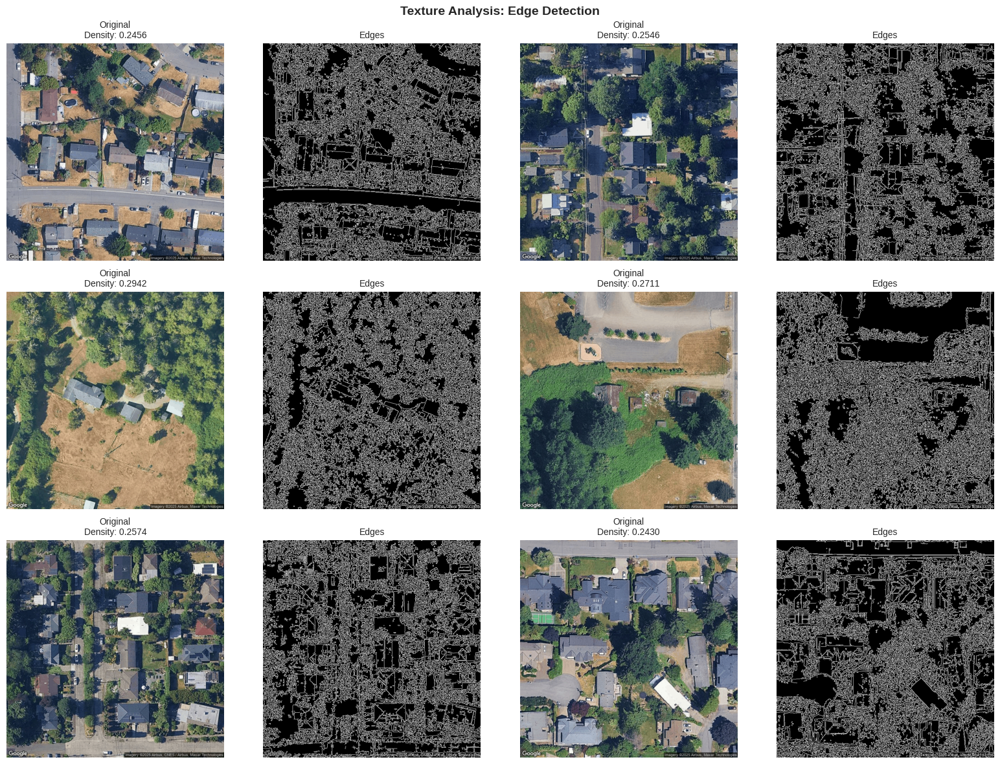

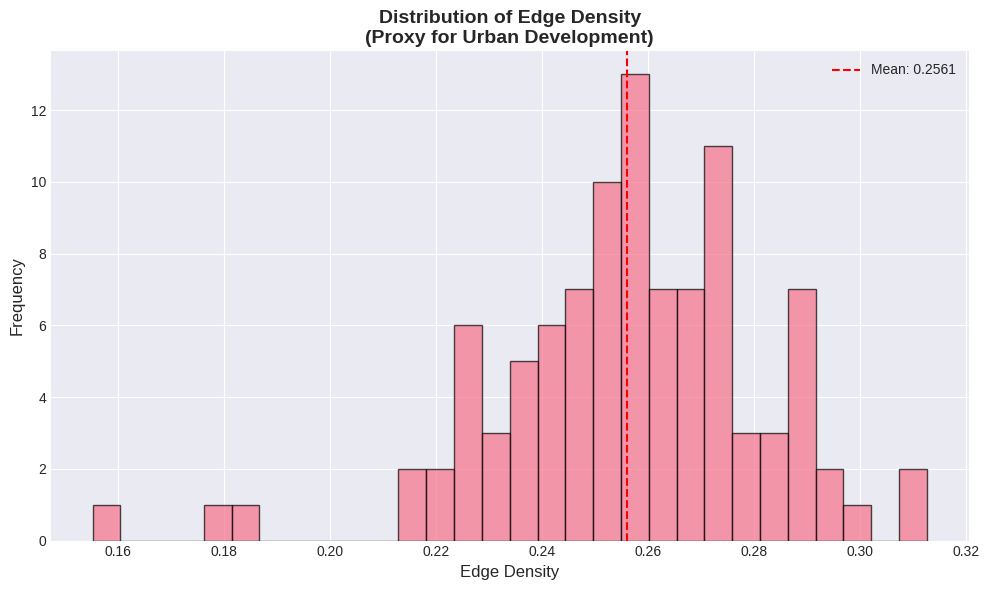


TEXTURE ANALYSIS SUMMARY
Mean Edge Density: 0.2561
Std Edge Density: 0.0255
Min Edge Density: 0.1551
Max Edge Density: 0.3126


In [ ]:
def analyze_image_texture(image_dir, n_samples=50):
    """
    Analyze texture using edge detection
    High edge density = urban, Low edge density = natural/open
    """
    image_files = glob.glob(os.path.join(image_dir, '*.*'))
    image_files = [f for f in image_files if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    if len(image_files) == 0:
        print("No images found")
        return

    sample_files = np.random.choice(image_files, min(n_samples, len(image_files)), replace=False)

    edge_densities = []
    sample_images = []
    sample_edges = []

    for img_path in sample_files[:6]:  # Keep 6 for visualization
        try:
            img = cv2.imread(img_path)
            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

            # Edge detection
            edges = cv2.Canny(gray, 50, 150)

            # Calculate edge density
            edge_density = np.sum(edges > 0) / edges.size
            edge_densities.append(edge_density)

            sample_images.append(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            sample_edges.append(edges)

        except:
            continue

    # Continue collecting edge densities for all samples
    for img_path in sample_files[6:]:
        try:
            img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
            edges = cv2.Canny(img, 50, 150)
            edge_density = np.sum(edges > 0) / edges.size
            edge_densities.append(edge_density)
        except:
            continue

    # Visualize sample images with edges
    fig, axes = plt.subplots(3, 4, figsize=(16, 12))

    for i in range(min(3, len(sample_images))):
        # Original image
        axes[i, 0].imshow(sample_images[i])
        axes[i, 0].set_title(f'Original\nDensity: {edge_densities[i]:.4f}', fontsize=10)
        axes[i, 0].axis('off')

        # Edge map
        axes[i, 1].imshow(sample_edges[i], cmap='gray')
        axes[i, 1].set_title('Edges', fontsize=10)
        axes[i, 1].axis('off')

        # If we have more samples
        if i+3 < len(sample_images):
            axes[i, 2].imshow(sample_images[i+3])
            axes[i, 2].set_title(f'Original\nDensity: {edge_densities[i+3]:.4f}', fontsize=10)
            axes[i, 2].axis('off')

            axes[i, 3].imshow(sample_edges[i+3], cmap='gray')
            axes[i, 3].set_title('Edges', fontsize=10)
            axes[i, 3].axis('off')

    plt.suptitle('Texture Analysis: Edge Detection', fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()

    # Distribution of edge densities
    plt.figure(figsize=(10, 6))
    plt.hist(edge_densities, bins=30, edgecolor='black', alpha=0.7)
    plt.xlabel('Edge Density', fontsize=12)
    plt.ylabel('Frequency', fontsize=12)
    plt.title('Distribution of Edge Density\n(Proxy for Urban Development)', fontsize=14, fontweight='bold')
    plt.axvline(np.mean(edge_densities), color='red', linestyle='--', label=f'Mean: {np.mean(edge_densities):.4f}')
    plt.legend()
    plt.tight_layout()
    plt.show()

    print("\n" + "="*60)
    print("TEXTURE ANALYSIS SUMMARY")
    print("="*60)
    print(f"Mean Edge Density: {np.mean(edge_densities):.4f}")
    print(f"Std Edge Density: {np.std(edge_densities):.4f}")
    print(f"Min Edge Density: {np.min(edge_densities):.4f}")
    print(f"Max Edge Density: {np.max(edge_densities):.4f}")

analyze_image_texture(IMAGE_DIR, n_samples=100)

---
## 5. MULTIMODAL CORRELATION ANALYSIS

### 5.1 Extract Visual Features for Correlation

In [ ]:
train_df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,price_category,image_name
0,9117000170,20150505T000000,268643,4,2.25,1810,9240,2.0,0,0,3,7,1810,0,1961,0,98055,47.4362,-122.187,1660,9240,250K-500K,img_00000_47.436200_-122.187000.png
1,6700390210,20140708T000000,245000,3,2.50,1600,2788,2.0,0,0,4,7,1600,0,1992,0,98031,47.4034,-122.187,1720,3605,<250K,img_00001_47.403400_-122.187000.png
2,7212660540,20150115T000000,200000,4,2.50,1720,8638,2.0,0,0,3,8,1720,0,1994,0,98003,47.2704,-122.313,1870,7455,<250K,img_00002_47.270400_-122.313000.png
3,8562780200,20150427T000000,352499,2,2.25,1240,705,2.0,0,0,3,7,1150,90,2009,0,98027,47.5321,-122.073,1240,750,250K-500K,img_00003_47.532100_-122.073000.png
4,7760400350,20141205T000000,232000,3,2.00,1280,13356,1.0,0,0,3,7,1280,0,1994,0,98042,47.3715,-122.074,1590,8071,<250K,img_00004_47.371500_-122.074000.png


In [30]:
print(visual_features_list)

[{'greenness': np.float64(4.78446533203126), 'blueness': np.float64(-6.3296752929687585), 'brightness': np.float64(114.81205322265625), 'edge_density': np.float64(0.2724951171875), 'image_name': 'img_00000_47.436200_-122.187000.png', 'price': 268643}, {'greenness': np.float64(7.429306640625001), 'blueness': np.float64(2.7259960937499983), 'brightness': np.float64(103.1610888671875), 'edge_density': np.float64(0.24560791015625), 'image_name': 'img_00001_47.403400_-122.187000.png', 'price': 245000}, {'greenness': np.float64(10.420229492187502), 'blueness': np.float64(13.566184082031242), 'brightness': np.float64(99.98460205078125), 'edge_density': np.float64(0.1779443359375), 'image_name': 'img_00002_47.270400_-122.313000.png', 'price': 200000}, {'greenness': np.float64(8.79467285156251), 'blueness': np.float64(-0.5860424804687483), 'brightness': np.float64(111.561298828125), 'edge_density': np.float64(0.2856298828125), 'image_name': 'img_00003_47.532100_-122.073000.png', 'price': 352499

In [29]:
import os
import cv2
import numpy as np
import pandas as pd
from tqdm import tqdm
from concurrent.futures import ProcessPoolExecutor
from multiprocessing import cpu_count


def extract_visual_features(image_path):
    """
    EXACT SAME FEATURE EXTRACTION AS ORIGINAL CODE
    """
    try:
        img = cv2.imread(image_path)

        if img is None:
            return None

        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        # Color-based features
        mean_colors = img_rgb.mean(axis=(0, 1))  # [R, G, B]

        greenness = mean_colors[1] - mean_colors[0]   # G - R
        blueness  = mean_colors[2] - mean_colors[1]   # B - G
        brightness = gray.mean()

        # Texture feature
        edges = cv2.Canny(gray, 50, 150)
        edge_density = np.sum(edges > 0) / edges.size

        return {
            "greenness": greenness,
            "blueness": blueness,
            "brightness": brightness,
            "edge_density": edge_density
        }

    except Exception:
        return None


# --------------------------------------------------
# HELPER FUNCTION FOR PARALLEL EXECUTION
# --------------------------------------------------
def process_row(args):
    image_name, price = args
    img_path = os.path.join(IMAGE_DIR, image_name)

    if not os.path.exists(img_path):
        return None

    features = extract_visual_features(img_path)

    if features is None:
        return None

    features["image_name"] = image_name
    features["price"] = price
    return features


# ==================================================
# PARALLEL FEATURE EXTRACTION
# ==================================================
print("Extracting handcrafted visual features (parallel CPU, exact logic)...")

inputs = list(zip(train_df["image_name"], train_df["price"]))
visual_features_list = []

# Use all CPU cores except one
num_workers = max(1, cpu_count() - 1)

with ProcessPoolExecutor(max_workers=num_workers) as executor:
    for result in tqdm(
        executor.map(process_row, inputs),
        total=len(inputs)
    ):
        if result is not None:
            visual_features_list.append(result)

# ==================================================
# CREATE DATAFRAME
# ==================================================
visual_df = pd.DataFrame(visual_features_list)

print(f"\nExtracted visual features for {len(visual_df)} images")
visual_df.head()


Extracting handcrafted visual features (parallel CPU, exact logic)...


100%|██████████| 16209/16209 [1:15:43<00:00,  3.57it/s]



Extracted visual features for 16209 images


,greenness,blueness,brightness,edge_density,image_name,price
0,4.784465,-6.329675,114.812053,0.272495,img_00000_47.436200_-122.187000.png,268643
1,7.429307,2.725996,103.161089,0.245608,img_00001_47.403400_-122.187000.png,245000
2,10.420229,13.566184,99.984602,0.177944,img_00002_47.270400_-122.313000.png,200000
3,8.794673,-0.586042,111.561299,0.285630,img_00003_47.532100_-122.073000.png,352499
4,-3.724412,-3.322280,107.277700,0.241111,img_00004_47.371500_-122.074000.png,232000


### 5.2 Visual Features vs Price Correlation

In [34]:
output_path = '/content/visual_features.csv'
visual_df.to_csv(output_path, index=False)
print(f"visual_df saved to {output_path}")

visual_df saved to /content/visual_features.csv


In [40]:
visual_df = pd.read_csv('/content/visual_features.csv')

In [36]:
visual_df.drop('image_name', axis=1, inplace=True)

In [41]:
visual_df.shape

(16209, 6)

VISUAL FEATURES - PRICE CORRELATION
greenness       0.185394
edge_density    0.083708
blueness        0.043717
brightness     -0.136220
Name: price, dtype: float64


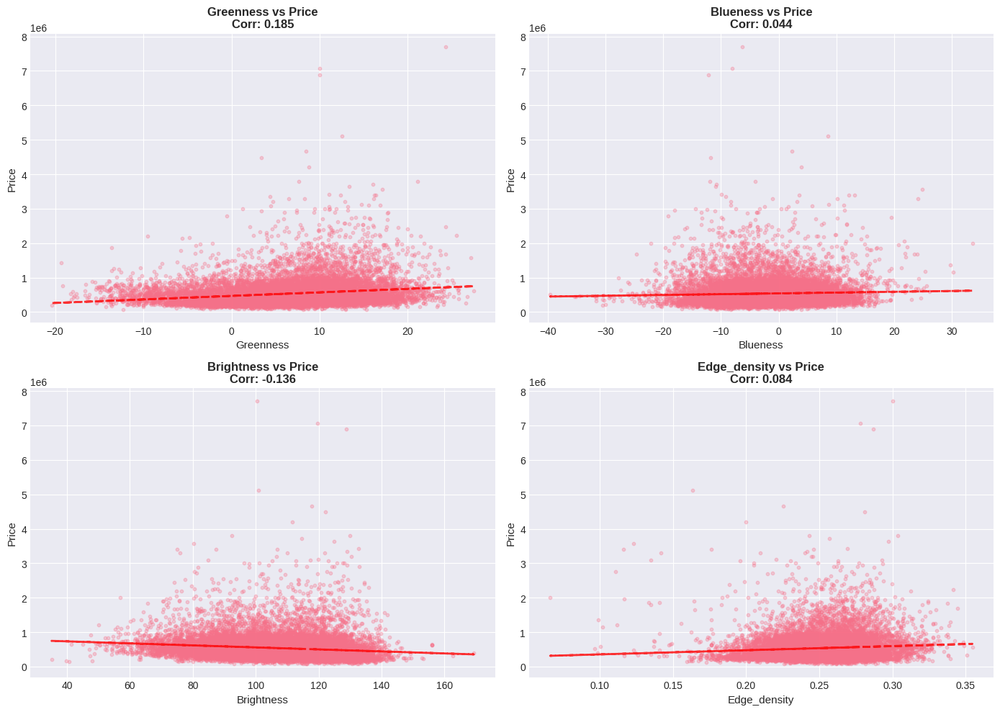

In [37]:
if len(visual_df) > 0:
    # Correlation analysis
    visual_price_corr = visual_df[['greenness', 'blueness', 'brightness', 'edge_density', 'price']].corr()['price'].drop('price')

    print("="*60)
    print("VISUAL FEATURES - PRICE CORRELATION")
    print("="*60)
    print(visual_price_corr.sort_values(ascending=False))

    # Visualization
    fig, axes = plt.subplots(2, 2, figsize=(14, 10))
    axes = axes.flatten()

    features_to_plot = ['greenness', 'blueness', 'brightness', 'edge_density']

    for idx, feature in enumerate(features_to_plot):
        axes[idx].scatter(visual_df[feature], visual_df['price'], alpha=0.3, s=10)
        axes[idx].set_xlabel(feature.capitalize(), fontsize=11)
        axes[idx].set_ylabel('Price', fontsize=11)
        axes[idx].set_title(f'{feature.capitalize()} vs Price\nCorr: {visual_price_corr[feature]:.3f}',
                           fontsize=12, fontweight='bold')

        # Add regression line
        z = np.polyfit(visual_df[feature], visual_df['price'], 1)
        p = np.poly1d(z)
        axes[idx].plot(visual_df[feature], p(visual_df[feature]), "r--", alpha=0.8, linewidth=2)

    plt.tight_layout()
    plt.show()
else:
    print("No visual features extracted. Please check your image directory and naming convention.")

### 5.3 Merge with Tabular Data for Combined Analysis

Combined dataset shape: (16209, 27)

Sample of combined data:
    price  sqft_living  grade  greenness  edge_density
0  268643         1810      7   4.784465      0.272495
1  245000         1600      7   7.429307      0.245608
2  200000         1720      8  10.420229      0.177944
3  352499         1240      7   8.794673      0.285630
4  232000         1280      7  -3.724412      0.241111


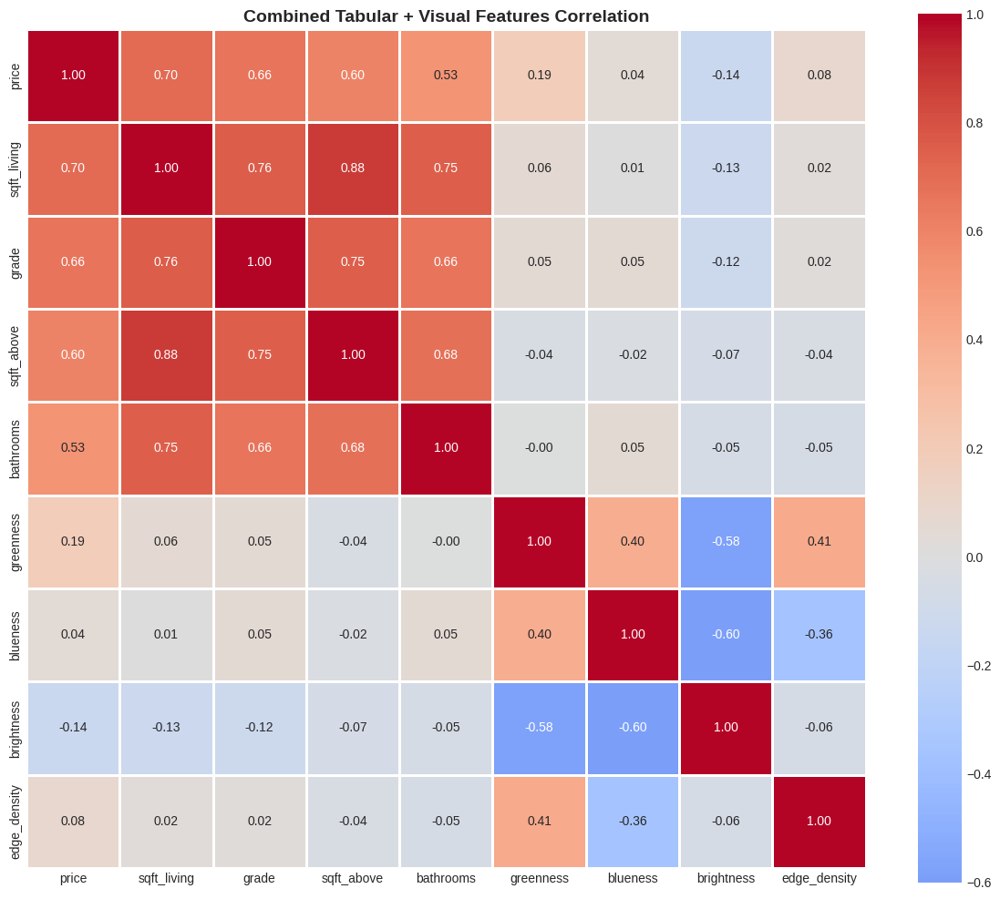

In [42]:
if len(visual_df) > 0:
    # Temporarily reload visual_df to ensure 'image_name' is present for merging.
    # This addresses the previous drop of 'image_name' from visual_df.
    visual_df_for_merge = pd.read_csv('/content/visual_features.csv')

    # Merge visual features with original data
    # Correcting the merge key from 'id' to 'image_name'
    combined_df = train_df.merge(visual_df_for_merge.drop('price', axis=1), on='image_name', how='left')

    print(f"Combined dataset shape: {combined_df.shape}")
    print(f"\nSample of combined data:")
    print(combined_df[['price', 'sqft_living', 'grade', 'greenness', 'edge_density']].head())

    # Full correlation matrix with visual features
    features_for_corr = ['price', 'sqft_living', 'grade', 'sqft_above', 'bathrooms',
                        'greenness', 'blueness', 'brightness', 'edge_density']
    features_for_corr = [f for f in features_for_corr if f in combined_df.columns]

    combined_corr = combined_df[features_for_corr].corr()

    plt.figure(figsize=(12, 10))
    sns.heatmap(combined_corr, annot=True, fmt='.2f', cmap='coolwarm',
                center=0, square=True, linewidths=1)
    plt.title('Combined Tabular + Visual Features Correlation', fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()
else:
    print("Cannot create combined analysis without visual features.")

---
## 6. KEY INSIGHTS & RECOMMENDATIONS

### Summary of Findings

In [43]:
print("="*80)
print("KEY EDA INSIGHTS")
print("="*80)

print("\n1. TABULAR DATA INSIGHTS:")
print(f"   - Price range: ${train_df['price'].min():,.0f} to ${train_df['price'].max():,.0f}")
print(f"   - Price distribution is {'right-skewed' if train_df['price'].skew() > 1 else 'approximately normal'}")
print(f"   - Top 3 correlates with price:")
price_corr_sorted = correlation_matrix['price'].sort_values(ascending=False)
for i, (feature, corr) in enumerate(price_corr_sorted[1:4].items(), 1):
    print(f"     {i}. {feature}: {corr:.3f}")

if len(visual_df) > 0:
    print("\n2. VISUAL FEATURE INSIGHTS:")
    print(f"   - Mean greenness (vegetation): {visual_df['greenness'].mean():.2f}")
    print(f"   - Mean edge density (urbanization): {visual_df['edge_density'].mean():.4f}")
    print(f"   - Visual feature most correlated with price: {visual_price_corr.idxmax()} ({visual_price_corr.max():.3f})")

print("\n3. RECOMMENDATIONS FOR MODELING:")
print("   - Consider log-transforming price to handle skewness")
print("   - Engineer interaction features (e.g., sqft_living * grade)")
print("   - Use CNN for automatic feature extraction from images")
print("   - Consider separate models for different price ranges")
print("   - Implement Grad-CAM for model explainability")

print("\n4. DATA QUALITY NOTES:")
missing_cols = train_df.isnull().sum()
if missing_cols.sum() > 0:
    print("   - Handle missing values in:")
    for col, count in missing_cols[missing_cols > 0].items():
        print(f"     • {col}: {count} ({100*count/len(train_df):.1f}%)")
else:
    print("   - No missing values detected")

print("\n" + "="*80)

KEY EDA INSIGHTS

1. TABULAR DATA INSIGHTS:
   - Price range: $75,000 to $7,700,000
   - Price distribution is right-skewed
   - Top 3 correlates with price:
     1. sqft_living: 0.701
     2. grade: 0.664
     3. sqft_above: 0.603

2. VISUAL FEATURE INSIGHTS:
   - Mean greenness (vegetation): 6.75
   - Mean edge density (urbanization): 0.2521
   - Visual feature most correlated with price: greenness (0.185)

3. RECOMMENDATIONS FOR MODELING:
   - Consider log-transforming price to handle skewness
   - Engineer interaction features (e.g., sqft_living * grade)
   - Use CNN for automatic feature extraction from images
   - Consider separate models for different price ranges
   - Implement Grad-CAM for model explainability

4. DATA QUALITY NOTES:
   - No missing values detected



---
## Next Steps

Based on this EDA, proceed with:

1. **Feature Engineering**
   - Create interaction terms
   - Engineer neighborhood features
   - Handle outliers

2. **Image Processing Pipeline**
   - Standardize image sizes
   - Implement data augmentation
   - Build CNN feature extractor

3. **Model Development**
   - Baseline model (tabular only)
   - Image-only model
   - Multimodal fusion architecture

4. **Explainability**
   - Implement Grad-CAM
   - Feature importance analysis
   - SHAP values for tabular features